## Diffusion Simulation in a 1D Room with Neumann Boundary Conditions

In [1]:

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation
%matplotlib inline

# Parameters
D = 1                 # Diffusion coefficient (arbitrary units)
Nt_gaps = 1000        # Number of timesteps
T = 5                 # Final time 
Nt_points = Nt_gaps + 1
Nx_spaces = 100       # Number of spatial intervals in x
L = 5                 # Length of the room (in meters)
Nx_points = Nx_spaces + 1 

# Create spatial and temporal grids
x = np.linspace(0, L, Nx_points)    # Spatial grid
t = np.linspace(0., T, Nt_points)   # Temporal grid

dx = x[1] - x[0]                    # Spatial step size
dt = t[1] - t[0]                    # Time step size

# Stability constant for the finite difference method
C = D * dt / (dx**2)
print("Delta x =", dx, "Delta t = ", dt, "C =", C)

# Function to compute the series solution for concentration C(x,t)
def C_xt(x, t, L, D, C0, n_terms):
    """
    Calculate concentration over time using a series solution.
    """
    C = C0 / L  # Constant term
    for n in range(1, n_terms):
        term = (2 * C0 / L) * np.cos(n * np.pi / 2) * np.cos(n * np.pi * x / L) * np.exp(- (n**2) * np.pi**2 * D * t / L**2)
        C += term
    return C

def I(x):
    """
    Define initial concentration profile, placing initial concentration at the center.
    """
    len_x = np.size(x)
    A = (len_x - 1) // 2
    i_x = np.zeros(len_x)
    i_x[int(A-1):int(A+2)] = 6.5  # Center peak
    return i_x

# Initialize concentration arrays
u = np.zeros(Nx_points)
u_old = np.zeros(Nx_points)
U = np.zeros((Nx_points, Nt_points))

# Initialize matrix A for the finite difference method
A = np.zeros((Nx_points, Nx_points))
b = np.zeros(Nx_points)

# Set up the matrix A for finite difference calculations with Neumann boundary conditions
for i in range(1, Nx_points-1): 
    A[i, i-1] = -C
    A[i, i+1] = -C
    A[i, i] = 1 + 2 * C

# Neumann boundary conditions (insulated ends)
A[0, 0] = 1 + 2 * C
A[0, 1] = -2 * C
A[Nx_points-1, Nx_points-1] = 1 + 2 * C
A[Nx_points-1, Nx_points-2] = -2 * C

# Set initial condition u(x,0) = I(x)
u_old = I(x)
U[:, 0] = u_old[:]

# Time-stepping loop to compute concentration evolution over time
for n in range(1, Nt_points): 
    # Update right-hand side and solve for the new concentration profile
    b[:] = u_old[:]
    u[:] = np.linalg.solve(A, b)
    u_old = u
    U[:, n] = u 


Delta x = 0.05 Delta t =  0.005 C = 1.9999999999999996


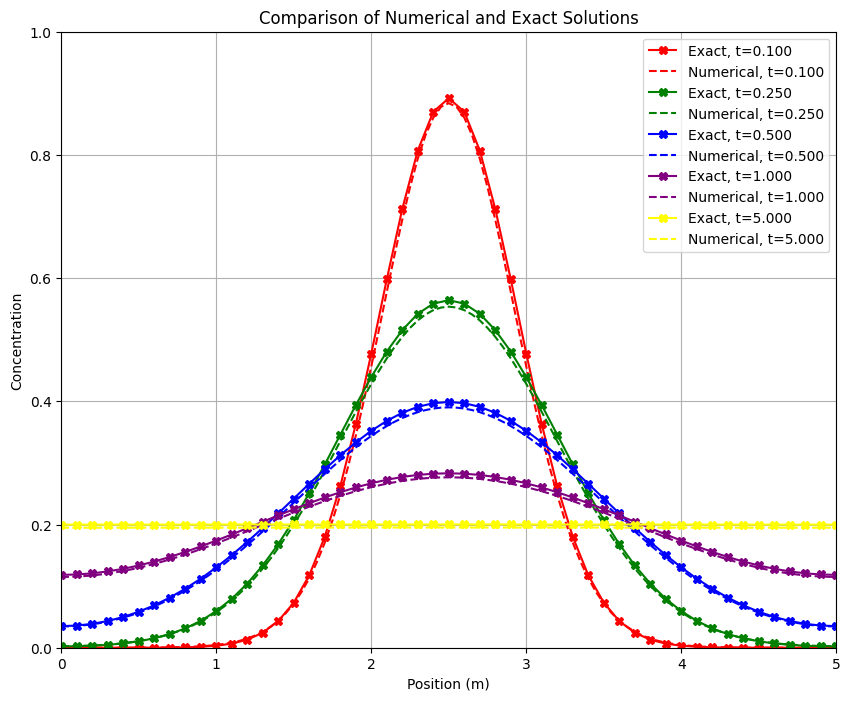

In [2]:
def plotting(U,L):
    size_t = np.size(U,1)-1 # number of time steps
    
    fig, ax = plt.subplots(1, 1, figsize=(10, 8))
    markers =['X','.','+','o']

    colours = ['r','g','b','purple','yellow'] # make comparison easy
    colour_pos = 0;

    N_dots = 50
    x_dots = np.linspace(0, L, N_dots+1) # spatial points to plot exact solution at

    # some arbitarily chosen time points to compare at
    for plot_pos in [int(size_t/50), int(size_t/20),int(size_t/10), int(size_t/5), int(size_t)]:
    
    # exact solution
        U_tplot = C_xt(x_dots,t[plot_pos],L, D=1, C0=1, n_terms=1000) 
        label = "Exact, t=" + "%0.3f" % (t[plot_pos],)
        ax.plot(x_dots,U_tplot,color = colours[colour_pos],marker = markers[0], label=label)

    # numerical solution
        label = "Numerical, t=" + "%0.3f" % (t[plot_pos],)
        ax.plot(x,U[:,plot_pos],color = colours[colour_pos],ls='--', label=label)
        colour_pos = colour_pos + 1;
    
    plt.xlim(0,L) # zoom in on area of interest
    plt.ylim(0, 1)
    ax.set_xlabel('Position (m)')
    ax.set_ylabel('Concentration')
    ax.set_title('Comparison of Numerical and Exact Solutions')
    ax.legend()
    ax.grid(True)
    plt.show()
plotting(U,L)

# Particle Diffusion Simulation with Shield Barrier

In [3]:

# Define regions where glass is present in the room
glass_start1 = 78   # Start index of the glass region
glass_end1 = 79     # End index of the glass region
D_air = 1           # Diffusion coefficient for air
D_glass1 = 0.05     # Diffusion coefficient for glass (slower diffusion)

# Set up variable diffusion coefficient D(x) across the spatial grid
D = np.ones(Nx_points) * D_air     # Default diffusion coefficient is for air
D[glass_start1:glass_end1] = D_glass1  # Set diffusion coefficient in the glass region

# Rebuild the matrix A with the spatially varying diffusion coefficient
A = np.zeros((Nx_points, Nx_points))
b = np.zeros(Nx_points)

# Set up the matrix A using variable diffusion for internal points
for i in range(1, Nx_points - 1):  # Interior points
    C_left = D[i - 1] * dt / (dx**2)
    C_right = D[i] * dt / (dx**2)
    A[i, i - 1] = -C_left          # Left neighbor
    A[i, i + 1] = -C_right         # Right neighbor
    A[i, i] = 1 + C_left + C_right # Center point

# Neumann boundary conditions (insulated boundaries)
A[0, 0] = 1 + 2 * D[0] * dt / (dx**2)    # Left boundary
A[0, 1] = -2 * D[0] * dt / (dx**2)
A[-1, -1] = 1 + 2 * D[-1] * dt / (dx**2) # Right boundary
A[-1, -2] = -2 * D[-1] * dt / (dx**2)

# Initialize concentration arrays
u = np.zeros(Nx_points)
u_old = np.zeros(Nx_points)
U = np.zeros((Nx_points, Nt_points))

# Set initial condition u(x,0) = I(x)
u_old = I(x)
U[:, 0] = u_old[:]

# Time-stepping loop to simulate concentration changes over time
for n in range(1, Nt_points): 
    # Update right-hand side vector b and solve for the new concentration profile
    b[:] = u_old[:]
    u[:] = np.linalg.solve(A, b)
    u_old = u
    U[:, n] = u


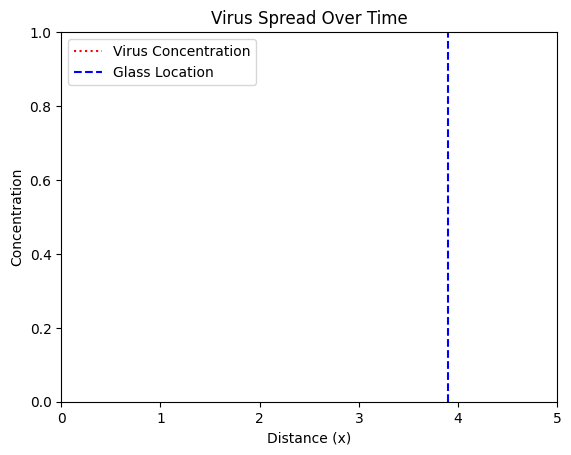

In [4]:
# Set up the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(0, 5)  # x-axis limits
ax.set_ylim(0, 1)  # y-axis limits

# Initialize the plot line
l, = ax.plot([], [], ':r', label='Virus Concentration')
ax.set_title('Virus Spread Over Time')
ax.set_xlabel('Distance (x)')
ax.set_ylabel('Concentration')
ax.axvline(x=x[glass_start1], color='b', linestyle='--', label='Glass Location')  # Vertical line at glass
ax.legend()

def init():
    """Initialize the background of each frame."""
    l.set_data([], [])
    return l,

def animate(i):
    """Update the line for each frame."""
    l.set_data(x, U[:, i])
    return l,

# Create the animation
ani = matplotlib.animation.FuncAnimation(fig, animate, frames=Nt_points, init_func=init, blit=True)

# Display the animation
from IPython.display import HTML
#HTML(ani.to_jshtml())
#ani.save('/mnt/data/animation.gif', writer='imagemagick')


# Function to Simulate Particle Diffusion with different shield coefficient


In [5]:

def calU(D_glass, glass_start):
    """
    Simulate particle diffusion in a 1D domain with a specified shield barrier.
    
    Parameters:
    - D_glass: Diffusion coefficient for the shield region (slower diffusion)
    - glass_start: Starting index for the shield region
    
    Returns:
    - U: Array representing the concentration of particle at each point in space over time
    """
    
    # Simulation parameters
    Nt_gaps = 1000          # Number of time steps
    T = 5                   # Total simulation time
    Nt_points = Nt_gaps + 1 # Total number of time points
    t = np.linspace(0., T, Nt_points)  # Time grid
    Nx_spaces = 100         # Number of spatial intervals
    L = 5                   # Length of the 1D domain (meters)
    D_air = 1               # Diffusion coefficient for air
    width = 1               # Width of the glass barrier
    Nx_points = Nx_spaces + 1
    x = np.linspace(0, L, Nx_points)   # Spatial grid
    dx = x[1] - x[0]        # Spatial step size
    dt = t[1] - t[0]        # Time step size

    glass_end = glass_start + width    # End index of the glass region
    
    # Set up variable diffusion coefficient D(x) across the spatial grid
    D = np.ones(Nx_points) * D_air       # Default diffusion coefficient is for air
    D[glass_start:glass_end] = D_glass   # Assign diffusion coefficient for the glass region

    # Initialize the matrix A with the variable diffusion coefficient
    A = np.zeros((Nx_points, Nx_points))
    b = np.zeros(Nx_points)

    # Set up the matrix A for interior points with variable diffusion
    for i in range(1, Nx_points - 1):
        C_left = D[i - 1] * dt / (dx**2)
        C_right = D[i] * dt / (dx**2)
        
        A[i, i - 1] = -C_left           # Left neighbor
        A[i, i + 1] = -C_right          # Right neighbor
        A[i, i] = 1 + C_left + C_right  # Center point

    # Neumann boundary conditions (insulated boundaries)
    A[0, 0] = 1 + 2 * D[0] * dt / (dx**2)    # Left boundary
    A[0, 1] = -2 * D[0] * dt / (dx**2)
    A[-1, -1] = 1 + 2 * D[-1] * dt / (dx**2) # Right boundary
    A[-1, -2] = -2 * D[-1] * dt / (dx**2)

    # Initialize concentration arrays
    u = np.zeros(Nx_points)
    u_old = np.zeros(Nx_points)
    U = np.zeros((Nx_points, Nt_points))

    # Set initial condition u(x,0) = I(x)
    u_old = I(x)
    U[:, 0] = u_old[:]

    # Time-stepping loop to compute concentration changes over time
    for n in range(1, Nt_points): 
        # Update right-hand side vector b and solve for the new concentration profile
        b[:] = u_old[:]
        u[:] = np.linalg.solve(A, b)
        u_old = u
        U[:, n] = u 

    return U  # Return the final concentration profile over time


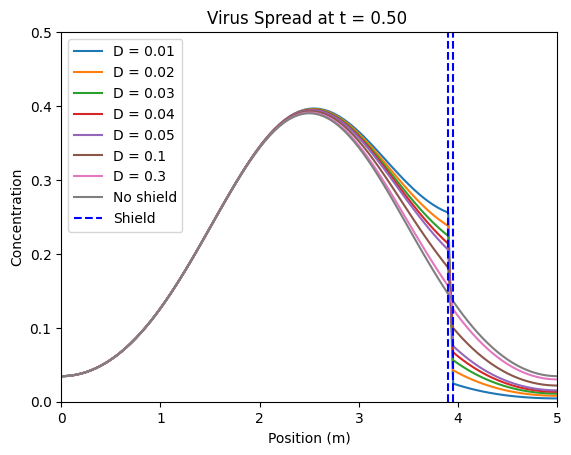

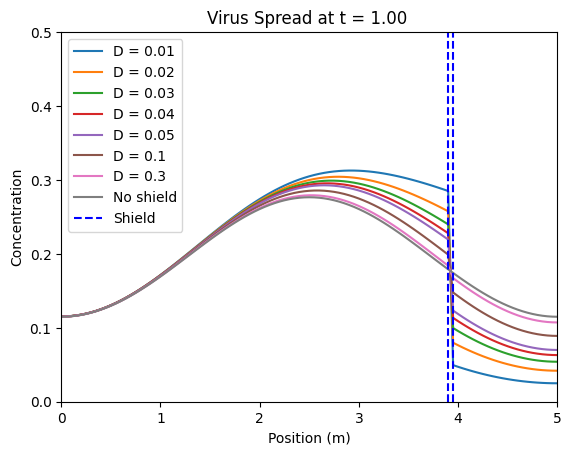

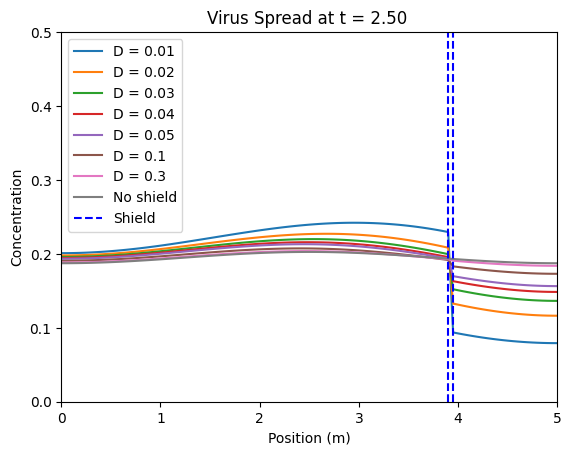

In [6]:
glass_start = 78 
glass_end=79
# Parameters for different diffusion constants
U1 = calU(0.01, glass_start)
U2 = calU(0.02, glass_start)
U3 = calU(0.03, glass_start)
U4 = calU(0.04, glass_start)
U5 = calU(0.05, glass_start)
U6 = calU(0.1, glass_start)
U7 = calU(0.3, glass_start)
U8 = calU(1, glass_start)
# Set the time steps at which to plot
timesteps_to_plot = [100,200,500]  # Adjust indices as needed


# Plot each timestep
for i in timesteps_to_plot:
    fig, ax = plt.subplots()
    ax.set_xlim(0, L)  # x-axis limits
    ax.set_ylim(0, 0.5)  # y-axis limits
    ax.plot(x, U1[:, i], label='D = 0.01')
    ax.plot(x, U2[:, i],  label='D = 0.02')
    ax.plot(x, U3[:, i],  label='D = 0.03')
    ax.plot(x, U4[:, i],  label='D = 0.04')
    ax.plot(x, U5[:, i],  label='D = 0.05')
    ax.plot(x, U6[:, i],  label='D = 0.1')
    ax.plot(x, U7[:, i],  label='D = 0.3')
    ax.plot(x, U8[:, i],  label='No shield')
    ax.axvline(x=x[glass_start], color='b', linestyle='--', label='Shield')
    ax.axvline(x=x[glass_end], color='b', linestyle='--')
    
    ax.set_title(f'Virus Spread at t = {t[i]:.2f} ')
    ax.set_xlabel('Position (m)')
    ax.set_ylabel('Concentration')
    ax.legend()
    
    plt.show()  # Display the plot for each timestep


# Analysis of optimal coefficient 


In [7]:
def calU_prop(D_glass,glass_start):
    Nt_gaps = 1000    # number of timesteps
    T = 5             # final time 
    Nt_points = Nt_gaps + 1
    t = np.linspace(0.,T,Nt_points)  # times at each time step
    Nx_spaces = 100   # number of spaces in x
    L = 5 
    D_air=1
    width=1
    Nx_points = Nx_spaces + 1 
    x = np.linspace(0, L, Nx_points)
    dx = x[1] - x[0] 
    dt = t[1] - t[0]

    total_particles_over_time = np.zeros(Nt_points)
    total_particles_after_glass = np.zeros(Nt_points)
    proportion_after_glass = np.zeros(Nt_points)

    # Define the region after the glass
    after_glass_region_length = (100-(glass_start+2))/100* L  # 10% of the total length
    after_glass_indices = np.where(x >= L - after_glass_region_length)[0]

    glass_end = glass_start+width    # index corresponding to the end of the glass
    # Set up variable diffusion coefficient D(x) over space
    D = np.ones(Nx_points) * D_air  # Default is air everywhere
    D[glass_start:glass_end] = D_glass  # Set diffusion coefficient for the glass region

    # Rebuild the matrix A with variable diffusion coefficient
    A = np.zeros((Nx_points, Nx_points))
    b = np.zeros(Nx_points)
    for i in range(1, Nx_points-1):  # interior points
        C_left = D[i-1] * dt / (dx**2)
        C_right = D[i] * dt / (dx**2)
            
        A[i, i-1] = -C_left  # left neighbor
        A[i, i+1] = -C_right  # right neighbor
        A[i, i] = 1 + C_left + C_right  # center

    # Neumann boundary conditions
    A[0,0] = 1 + 2*D[0]*dt/(dx**2)  # Left boundary
    A[0,1] = -2*D[0]*dt/(dx**2)
    A[-1,-1] = 1 + 2*D[-1]*dt/(dx**2)  # Right boundary
    A[-1,-2] = -2*D[-1]*dt/(dx**2)

    # set up structures to hold U interim arrays
    u     = np.zeros(Nx_points)
    u_old = np.zeros(Nx_points)
    U     = np.zeros((Nx_points,Nt_points))
    # Set initial condition u(x,0) = I(x)
    u_old = I(x)


    # initialise matrices U for first time step
    U[:,0] = u_old[:]


    #perform time-stepping
    for n in range(1, Nt_points): # timestep for 1 to t = T-1 so last step finishes on t=T
        # Compute b and solve linear system
        b[:] = u_old[:]
        u[:] = np.linalg.solve(A,b)
        # Update u_old before next step
        u_old = u
        U[:,n] = u 

        # Calculate total number of particles in the entire domain
        total_particles = np.sum(u) 
        total_particles_over_time[n] = total_particles  # Store total in the array

        # Calculate total number of particles in the region after the glass
        total_particles_after_glass[n] = np.sum(u[after_glass_indices]) 

    # Calculate proportion of particles after the glass
        if total_particles > 0:
            proportion_after_glass[n] = total_particles_after_glass[n] / total_particles
        else:
            proportion_after_glass[n] = 0  # Handle case where total particles are zero
    
    return proportion_after_glass
        

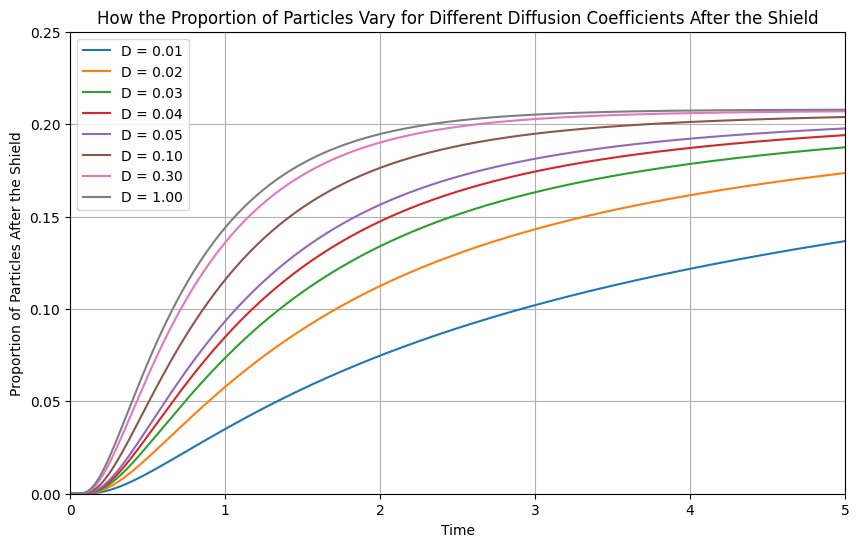

In [8]:
def main():
    # Parameters for testing
    D_glass_values = [0.01,0.02, 0.03, 0.04, 0.05,0.1,0.3,1]  # Example D_glass values
    glass_start = 78  # Example starting index for glass

    plt.figure(figsize=(10, 6))  # Create a single figure for all plots

    # Loop through D_glass values and calculate proportions
    for D_glass in D_glass_values:
        proportion_after_glass = calU_prop(D_glass, glass_start)

        # Plotting the proportion for this D_glass value
        plt.plot(np.linspace(0, 5, 1001), proportion_after_glass, label=f'D = {D_glass:.2f}')

    plt.xlabel('Time')
    plt.ylabel('Proportion of Particles After the Shield')
    plt.title('How the Proportion of Particles Vary for Different Diffusion Coefficients After the Shield')
    plt.grid()
    plt.legend()
    plt.xlim(0, 5)  # Set x-axis limits for better visibility
    plt.ylim(0, 0.25)  # Set y-axis limits based on proportion
    plt.show()

# Run the main function
main()

In [9]:
import pandas as pd

def main2():
    # Parameters for testing
    D_glass_values = [0.01,0.02, 0.03, 0.04, 0.05,0.06025905,0.1,1]    # Example D_glass values
    glass_start = 78  # Example starting index for glass
    times_to_check = [1]  # Times to check for proportions

    # Prepare a DataFrame to store the results
    results = pd.DataFrame(index=times_to_check, columns=[f'D_glass = {D:.2f}' for D in D_glass_values])

    # Loop through D_glass values and calculate proportions
    for D_glass in D_glass_values:
        proportion_after_glass = calU_prop(D_glass, glass_start)

        # Fill the DataFrame with the proportions at the specified times
        for time in times_to_check:
            results.at[time, f'D_glass = {D_glass:.2f}'] = proportion_after_glass[time * 200] *100 # Time index

    # Print the results as a table
    print("Percentage of Particles After Glass at Specified Times:")
    print(results)

# Run the main function
main2()
print(calU_prop(D_glass=0.06025905, glass_start=78))

Percentage of Particles After Glass at Specified Times:
  D_glass = 0.01 D_glass = 0.02 D_glass = 0.03 D_glass = 0.04 D_glass = 0.05  \
1       3.497159       5.773719       7.343573        8.47738       9.327564   

  D_glass = 0.06 D_glass = 0.10 D_glass = 1.00  
1           10.0      11.569494      14.390288  
[0.00000000e+00 1.16863941e-10 1.29938391e-09 ... 1.99930268e-01
 1.99946967e-01 1.99963619e-01]


# Two shields

In [10]:
# Define regions where the glass is present in the room
glass_start1 = 63 # index corresponding to the start of the glass
glass_end1 = 64
glass_start2 = 78 # index corresponding to the start of the glass
glass_end2 = 79   # index corresponding to the end of the glass
D_air = 1         # Diffusion coefficient for air
D_glass1 = 0.1     # Diffusion coefficient for glass (slower diffusion)
D_glass2 = 0.1
# Set up variable diffusion coefficient D(x) over space
D = np.ones(Nx_points) * D_air  # Default is air everywhere
D[glass_start1:glass_end1] = D_glass1  # Set diffusion coefficient for the glass region
D[glass_start2:glass_end2] = D_glass2 
# Rebuild the matrix A with variable diffusion coefficient
A = np.zeros((Nx_points, Nx_points))
b = np.zeros(Nx_points)
for i in range(1, Nx_points-1):  # interior points
    C_left = D[i-1] * dt / (dx**2)
    C_right = D[i] * dt / (dx**2)
    A[i, i-1] = -C_left  # left neighbor
    A[i, i+1] = -C_right  # right neighbor
    A[i, i] = 1 + C_left + C_right  # center
    
# Neumann boundary conditions
A[0,0] = 1 + 2*D[0]*dt/(dx**2)  # Left boundary
A[0,1] = -2*D[0]*dt/(dx**2)
A[-1,-1] = 1 + 2*D[-1]*dt/(dx**2)  # Right boundary
A[-1,-2] = -2*D[-1]*dt/(dx**2)



# set up structures to hold U interim arrays
u     = np.zeros(Nx_points)
u_old = np.zeros(Nx_points)
U     = np.zeros((Nx_points,Nt_points))
# Set initial condition u(x,0) = I(x)
u_old = I(x)


# initialise matrices U for first time step
U[:,0] = u_old[:]


#perform time-stepping
for n in range(1, Nt_points): # timestep for 1 to t = T-1 so last step finishes on t=T
    # Compute b and solve linear system
    b[:] = u_old[:]
    u[:] = np.linalg.solve(A,b)
    # Update u_old before next step
    u_old = u
    U[:,n] = u 


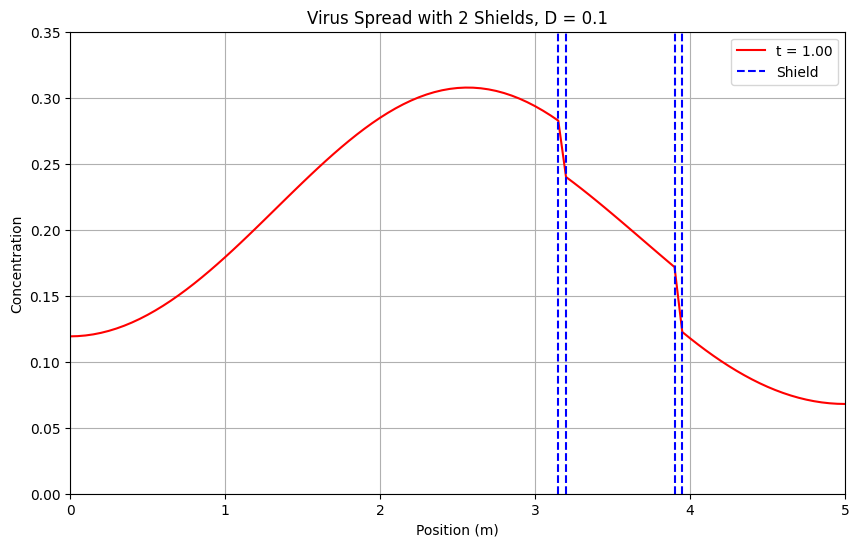

In [11]:
import os

# Create a directory to save plots if it doesn't exist
output_dir = 'virus_concentration_plots'
os.makedirs(output_dir, exist_ok=True)


# Select specific time steps to plot 
time_indices_to_plot = [200]  # Example indices
colors = ['r', 'g', 'b', 'c', 'm', 'y']  # Colors for different time steps

plt.figure(figsize=(10, 6))

for idx, n in enumerate(time_indices_to_plot):
    if n < Nt_points:  # Ensure the index is within bounds
        plt.plot(x, U[:, n], label=f't = {n * dt:.2f}', color=colors[idx])

# Add vertical lines for glass barriers
plt.axvline(x=x[glass_start1], color='b', linestyle='--', label='Shield')
plt.axvline(x=x[glass_end1], color='b', linestyle='--')
plt.axvline(x=x[glass_start2], color='b', linestyle='--')
plt.axvline(x=x[glass_end2], color='b', linestyle='--')

# Add labels and legend
plt.title('Virus Spread with 2 Shields, D = 0.1')
plt.xlabel('Position (m)')
plt.ylabel('Concentration')
plt.legend()
plt.grid()
plt.xlim(0, L)
plt.ylim(0, 0.35)  # Set y-axis limit slightly above max concentration

# Save the plot as an image
plt.savefig(os.path.join(output_dir, 'combined_plot.png'))
plt.show()  # Display the plot



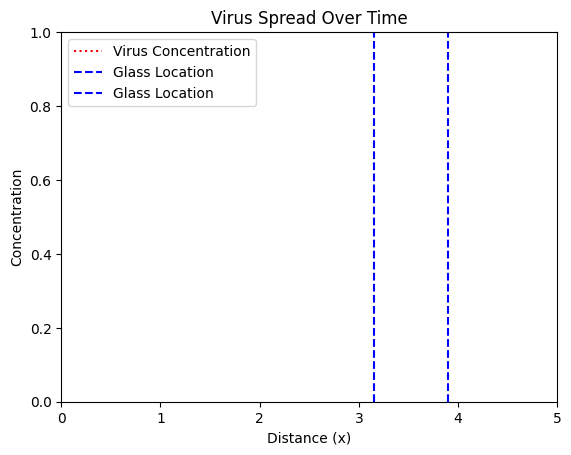

In [12]:
# Set up the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(0, 5)  # x-axis limits
ax.set_ylim(0, 1)  # y-axis limits

# Initialize the plot line
l, = ax.plot([], [], ':r', label='Virus Concentration')
ax.set_title('Virus Spread Over Time')
ax.set_xlabel('Distance (x)')
ax.set_ylabel('Concentration')
ax.axvline(x=x[glass_start1], color='b', linestyle='--', label='Glass Location')  # Vertical line at glass
ax.axvline(x=x[glass_start2], color='b', linestyle='--', label='Glass Location')  # Vertical line at glass
ax.legend()

def init():
    """Initialize the background of each frame."""
    l.set_data([], [])
    return l,

def animate(i):
    """Update the line for each frame."""
    l.set_data(x, U[:, i])
    return l,

# Create the animation
ani = matplotlib.animation.FuncAnimation(fig, animate, frames=Nt_points, init_func=init, blit=True)

# Display the animation
from IPython.display import HTML
#HTML(ani.to_jshtml())


# Proportion for two shields 

In [13]:
def calU_prop2(D_glass,glass_start1,glass_start2):
    Nt_gaps = 1000    # number of timesteps
    T = 5             # final time 
    Nt_points = Nt_gaps + 1
    t = np.linspace(0.,T,Nt_points)  # times at each time step
    Nx_spaces = 100   # number of spaces in x
    L = 5 
    D_air=1
    width=1
    Nx_points = Nx_spaces + 1 
    x = np.linspace(0, L, Nx_points)
    dx = x[1] - x[0] 
    dt = t[1] - t[0]



    # Define regions where the glass is present in the room
    
    D_air = 1         # Diffusion coefficient for air
    glass_end1 = glass_start1+width    # index corresponding to the end of the glass
    glass_end2 = glass_start2+width  
    
    
    #    Set up variable diffusion coefficient D(x) over space
    D = np.ones(Nx_points) * D_air  # Default is air everywhere
    D[glass_start1:glass_end1] = D_glass  # Set diffusion coefficient for the glass region
    D[glass_start2:glass_end2] = D_glass 


    total_particles_over_time = np.zeros(Nt_points)
    total_particles_after_glass = np.zeros(Nt_points)
    proportion_after_glass = np.zeros(Nt_points)

    # Define the region after the glass
    after_glass_region_length = (100-(glass_start2+2))/100* L  # 10% of the total length
    after_glass_indices = np.where(x >= L - after_glass_region_length)[0]


    # Rebuild the matrix A with variable diffusion coefficient
    A = np.zeros((Nx_points, Nx_points))
    b = np.zeros(Nx_points)
    for i in range(1, Nx_points-1):  # interior points
        C_left = D[i-1] * dt / (dx**2)
        C_right = D[i] * dt / (dx**2)
            
        A[i, i-1] = -C_left  # left neighbor
        A[i, i+1] = -C_right  # right neighbor
        A[i, i] = 1 + C_left + C_right  # center

    # Neumann boundary conditions
    A[0,0] = 1 + 2*D[0]*dt/(dx**2)  # Left boundary
    A[0,1] = -2*D[0]*dt/(dx**2)
    A[-1,-1] = 1 + 2*D[-1]*dt/(dx**2)  # Right boundary
    A[-1,-2] = -2*D[-1]*dt/(dx**2)

    # set up structures to hold U interim arrays
    u     = np.zeros(Nx_points)
    u_old = np.zeros(Nx_points)
    U     = np.zeros((Nx_points,Nt_points))
    # Set initial condition u(x,0) = I(x)
    u_old = I(x)


    # initialise matrices U for first time step
    U[:,0] = u_old[:]


    #perform time-stepping
    for n in range(1, Nt_points): # timestep for 1 to t = T-1 so last step finishes on t=T
        # Compute b and solve linear system
        b[:] = u_old[:]
        u[:] = np.linalg.solve(A,b)
        # Update u_old before next step
        u_old = u
        U[:,n] = u 

        # Calculate total number of particles in the entire domain
        total_particles = np.sum(u) 
        total_particles_over_time[n] = total_particles  # Store total in the array

        # Calculate total number of particles in the region after the glass
        total_particles_after_glass[n] = np.sum(u[after_glass_indices]) 

    # Calculate proportion of particles after the glass
        if total_particles > 0:
            proportion_after_glass[n] = total_particles_after_glass[n] / total_particles
        else:
            proportion_after_glass[n] = 0  # Handle case where total particles are zero
    
    return proportion_after_glass
        

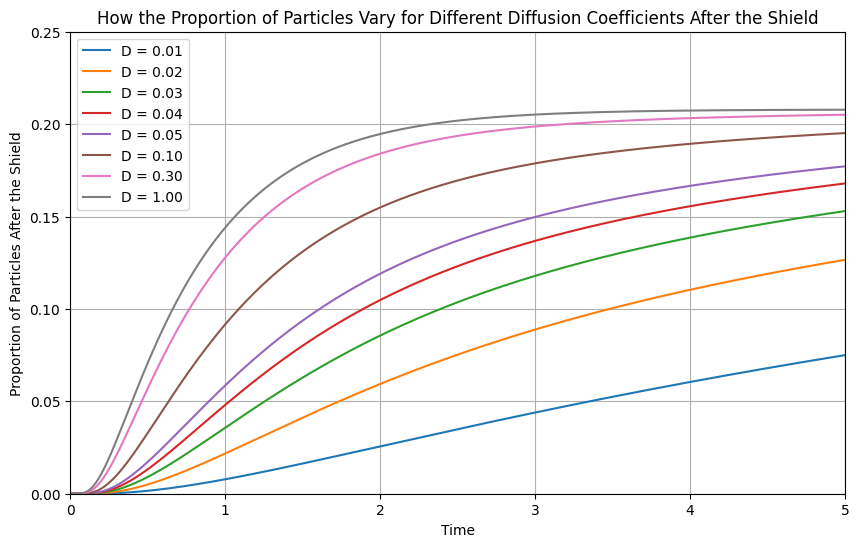

In [14]:
def main_2():
    # Parameters for testing
    D_glass_values = [0.01,0.02, 0.03, 0.04, 0.05,0.1,0.3,1]  # Example D_glass values
    glass_start1 = 63  # Example starting index for glass
    glass_start2=78
    plt.figure(figsize=(10, 6))  # Create a single figure for all plots

    # Loop through D_glass values and calculate proportions
    for D_glass in D_glass_values:
        proportion_after_glass = calU_prop2(D_glass, glass_start1,glass_start2)

        # Plotting the proportion for this D_glass value
        plt.plot(np.linspace(0, 5, 1001), proportion_after_glass, label=f'D = {D_glass:.2f}')

    plt.xlabel('Time')
    plt.ylabel('Proportion of Particles After the Shield')
    plt.title('How the Proportion of Particles Vary for Different Diffusion Coefficients After the Shield')
    plt.grid()
    plt.legend()
    plt.xlim(0, 5)  # Set x-axis limits for better visibility
    plt.ylim(0, 0.25)  # Set y-axis limits based on proportion
    plt.show()

# Run the main function
main_2()

In [15]:
import pandas as pd

def main2_2():
    # Parameters for testing
    D_glass_values = [0.01,0.02, 0.03, 0.04, 0.05,0.06,0.1,0.15,0.2,0.3,1]    # Example D_glass values
    glass_start1 = 63  # Example starting index for glass
    glass_start2=78
    times_to_check = [1]  # Times to check for proportions

    # Prepare a DataFrame to store the results
    results = pd.DataFrame(index=times_to_check, columns=[f'D_glass = {D:.2f}' for D in D_glass_values])

    # Loop through D_glass values and calculate proportions
    for D_glass in D_glass_values:
        proportion_after_glass = calU_prop2(D_glass, glass_start1,glass_start2)

        # Fill the DataFrame with the proportions at the specified times
        for time in times_to_check:
            results.at[time, f'D_glass = {D_glass:.2f}'] = proportion_after_glass[time * 200] *100 # Time index

    # Print the results as a table
    print("Percentage of Particles After Glass at Specified Times:")
    print(results)

# Run the main function
main2_2()

Percentage of Particles After Glass at Specified Times:
  D_glass = 0.01 D_glass = 0.02 D_glass = 0.03 D_glass = 0.04 D_glass = 0.05  \
1        0.77955       2.172067        3.56512       4.798437        5.85036   

  D_glass = 0.06 D_glass = 0.10 D_glass = 0.15 D_glass = 0.20 D_glass = 0.30  \
1       6.739011       9.151315      10.780251      11.725453      12.766128   

  D_glass = 1.00  
1      14.390288  


# Two sources

In [16]:
def I_2(x): # initial u(x,0)
    len_x = np.size(x)
    A=(len_x-1)/3
    i_x = np.zeros(len_x)
    i_x[int(A-1)]=6.5
    i_x[int(A+1)]=6.5
    i_x[int(A)]=6.5
    B=2*(len_x-1)/3
    i_x[int(B-1)]=6.5
    i_x[int(B+1)]=6.5
    i_x[int(B)]=6.5
    return i_x

u = np.zeros(Nx_points)
u_old = np.zeros(Nx_points)
U = np.zeros((Nx_points, Nt_points))

A = np.zeros((Nx_points, Nx_points))
b = np.zeros(Nx_points)

# Set up the matrix A
for i in range(1, Nx_points - 1):  # rows from 1 to Nx-2
    A[i, i - 1] = -C
    A[i, i + 1] = -C
    A[i, i] = 1 + 2 * C

# Implement Neumann BC
A[0, 0] = 1 + 2 * C
A[0, 1] = -2 * C
A[Nx_points - 1, Nx_points - 1] = 1 + 2 * C
A[Nx_points - 1, Nx_points - 2] = -2 * C

# Set initial condition for the first virus
u_old = I_2(x)  # Virus 1 starts at center 1/3
U[:, 0] = u_old[:]  # Initialize first time step

# Perform time-stepping
for n in range(1, Nt_points):  # timestep for 1 to t = T-1
    b[:] = u_old[:]  # Copy u_old into b
    u[:] = np.linalg.solve(A, b)  # Solve for u

    u_old = u  # Update u_old for the next time step
    U[:, n] = u  # Store the result


C:\Users\stavr\AppData\Local\Temp\ipykernel_20152\2974931357.py:14: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


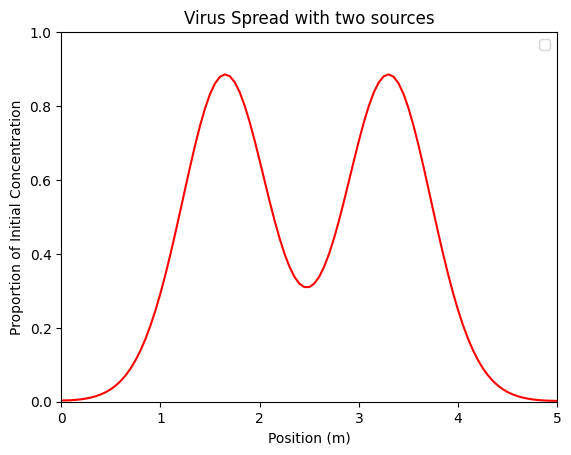

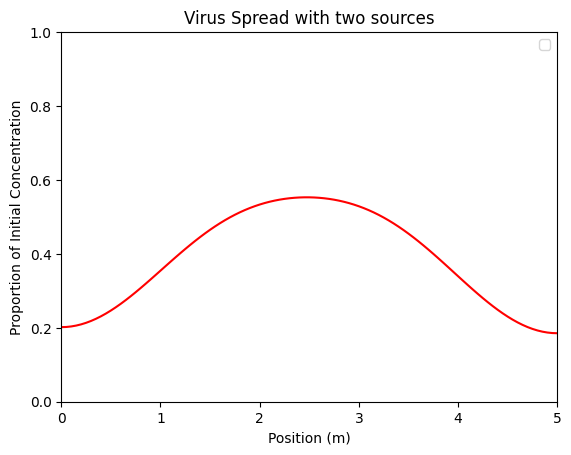

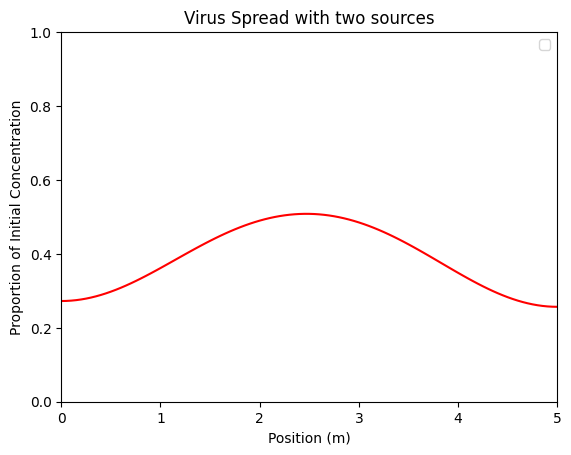

In [17]:
# Set the time steps at which to plot
timesteps_to_plot = [20,100, 150]  # Adjust indices as needed


# Plot each timestep
for i in timesteps_to_plot:
    fig, ax = plt.subplots()
    ax.set_xlim(0, L)  # x-axis limits
    ax.set_ylim(0, 1)  # y-axis limits
    ax.plot(x, U[:, i],color='r')
    ax.set_title(f'Virus Spread with two sources')
    ax.set_xlabel('Position (m)')
    ax.set_ylabel('Proportion of Initial Concentration')
    ax.legend()
    
    plt.show()  # Display the plot for each timestep


# Extended Simulation of 1D Diffusion with Variable Barriers


In [24]:
def I(x, center):  # initial u(x,0) with a center parameter
    len_x = np.size(x)
    i_x = np.zeros(len_x)
    # Set the concentration at the specified center and its neighbors
    i_x[center] =6.5
    if center - 1 >= 0:
        i_x[center - 1] = 6.5
    if center + 1 < len_x:
        i_x[center + 1] = 6.5
    return i_x




def calU_prop3(D_glass,glass_start1,glass_start2):
    Nt_gaps = 1000    # number of timesteps
    T = 5             # final time 
    Nt_points = Nt_gaps + 1
    t = np.linspace(0.,T,Nt_points)  # times at each time step
    Nx_spaces = 100   # number of spaces in x
    L = 5 
    D_air=1
    width=1
    Nx_points = Nx_spaces + 1 
    x = np.linspace(0, L, Nx_points)
    dx = x[1] - x[0] 
    dt = t[1] - t[0]



    # Define regions where the glass is present in the room
    
    D_air = 1         # Diffusion coefficient for air
    glass_end1 = glass_start1+width    # index corresponding to the end of the glass
    glass_end2 = glass_start2+width  
    
    
    #    Set up variable diffusion coefficient D(x) over space
    D = np.ones(Nx_points) * D_air  # Default is air everywhere
    D[glass_start1:glass_end1] = D_glass  # Set diffusion coefficient for the glass region
    D[glass_start2:glass_end2] = D_glass 


    total_particles_over_time = np.zeros(Nt_points)
    total_particles_after_glass = np.zeros(Nt_points)
    proportion_after_glass = np.zeros(Nt_points)

    # Define the region after the glass
    after_glass_region_length = (100-(glass_start2+2))/100* L  # 10% of the total length
    after_glass_indices = np.where(x >= L - after_glass_region_length)[0]

    
    # Rebuild the matrix A with variable diffusion coefficient
    A = np.zeros((Nx_points, Nx_points))
    b = np.zeros(Nx_points)
    for i in range(1, Nx_points-1):  # interior points
        C_left = D[i-1] * dt / (dx**2)
        C_right = D[i] * dt / (dx**2)
            
        A[i, i-1] = -C_left  # left neighbor
        A[i, i+1] = -C_right  # right neighbor
        A[i, i] = 1 + C_left + C_right  # center

    # Neumann boundary conditions
    A[0,0] = 1 + 2*D[0]*dt/(dx**2)  # Left boundary
    A[0,1] = -2*D[0]*dt/(dx**2)
    A[-1,-1] = 1 + 2*D[-1]*dt/(dx**2)  # Right boundary
    A[-1,-2] = -2*D[-1]*dt/(dx**2)

    # set up structures to hold U interim arrays
    u     = np.zeros(Nx_points)
    u_old = np.zeros(Nx_points)
    U     = np.zeros((Nx_points,Nt_points))
    # Set initial condition u(x,0) = I(x)
    u_old = I(x, int((Nx_points - 1) / 2))


    # initialise matrices U for first time step
    U[:,0] = u_old[:]


    #perform time-stepping
    for n in range(1, Nt_points): # timestep for 1 to t = T-1 so last step finishes on t=T
        # Compute b and solve linear system
        b[:] = u_old[:]
        u[:] = np.linalg.solve(A,b)
        if n > 200:  # Second virus starts diffusing after 200 timesteps
            if n == 201:  # Introduce the second virus only at the 201st timestep
                u += I(x, int(((Nx_points - 1)) / 3))  # Virus 2 starts at center 2/3


        # Update u_old before next step
        u_old = u
        U[:,n] = u 

        # Calculate total number of particles in the entire domain
        total_particles = np.sum(u) 
        total_particles_over_time[n] = total_particles  # Store total in the array

        # Calculate total number of particles in the region after the glass
        total_particles_after_glass[n] = np.sum(u[after_glass_indices]) 

    # Calculate proportion of particles after the glass
        if total_particles > 0:
            proportion_after_glass[n] = total_particles_after_glass[n] / total_particles
        else:
            proportion_after_glass[n] = 0  # Handle case where total particles are zero
    
    return U
        

Animation size has reached 20986389 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


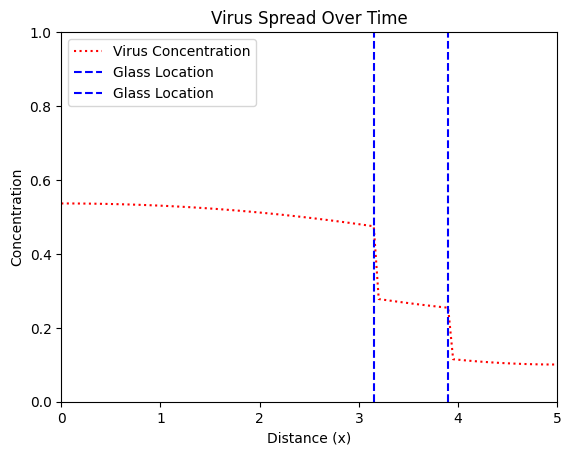

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.animation

U=calU_prop3(D_glass=0.01,glass_start1=63,glass_start2=78)

# Set up the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(0, 5)  # x-axis limits
ax.set_ylim(0, 1)  # y-axis limits

# Initialize the plot line
l, = ax.plot([], [], ':r', label='Virus Concentration')
ax.set_title('Virus Spread Over Time')
ax.set_xlabel('Distance (x)')
ax.set_ylabel('Concentration')
ax.axvline(x=x[63], color='b', linestyle='--', label='shield')  # Vertical line at glass
ax.axvline(x=x[78], color='b', linestyle='--', label='Shield')  # Vertical line at glass
ax.legend()

def init():
    """Initialize the background of each frame."""
    l.set_data([], [])
    return l,

def animate(i):
    """Update the line for each frame."""
    l.set_data(x, U[:, i])
    return l,

# Create the animation
ani3 = matplotlib.animation.FuncAnimation(fig, animate, frames=Nt_points, init_func=init, blit=True)

# Display the animation
from IPython.display import HTML
HTML(ani3.to_jshtml())